### EDA su dati da file in **formato Garmin fit**
* mostra come caricare un file in formato fit
* come calcolare alcune statistiche e plottare alcune serie temporali

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

# maps
import folium

from utility import load_in_pandas_from_fit, plot_vs_altitude, compute_total_distance

#### Load the file in a DataFrame

In [10]:
POWER = True
CADENCE = True

FNAME = "file2.fit"

# specifying true we load also power and cadence
df = load_in_pandas_from_fit(FNAME, power=POWER, cadence=POWER)

In [11]:
df.head(10)

,id,timestamp,position_lat,position_long,altitude,temperature,speed,distance,heart_rate,cadence,power,n_power
0,1,2019-05-12 10:24:23,44.487148,11.293778,80.0,13,38.99,0.0,138,84,68,224.7
1,2,2019-05-12 10:24:24,44.487095,11.293676,80.0,13,39.20,11.0,138,84,43,221.6
2,3,2019-05-12 10:24:25,44.487019,11.293573,80.0,13,39.38,22.0,138,84,69,218.4
3,4,2019-05-12 10:24:26,44.486946,11.293468,80.0,13,39.38,33.0,138,84,41,215.4
4,5,2019-05-12 10:24:27,44.486881,11.293366,80.0,13,38.99,44.0,138,83,34,212.7
5,6,2019-05-12 10:24:28,44.486809,11.293261,80.0,13,38.81,54.0,137,82,67,211.3
6,7,2019-05-12 10:24:29,44.486736,11.293152,80.0,13,38.81,65.0,137,82,89,210.5
7,8,2019-05-12 10:24:30,44.486671,11.293044,80.0,13,39.10,76.0,135,77,30,208.4
8,9,2019-05-12 10:24:31,44.486607,11.292944,80.0,13,39.10,87.0,134,66,27,207.8
9,10,2019-05-12 10:24:32,44.486538,11.292843,80.0,13,38.41,98.0,133,79,12,210.4


#### Compute Statistics

In [12]:
all_cols = df.columns
exc_cols = ['id','timestamp','position_lat','position_long']
allow_cols = list(set(all_cols) - set(exc_cols))
                  
df[allow_cols].describe()

,cadence,speed,heart_rate,temperature,power,distance,altitude,n_power
count,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000
mean,79.414374,42.371465,150.008071,16.852371,250.993284,98295.167717,159.711281,329.541455
std,29.528476,12.492806,21.164449,4.328191,167.421615,58497.897084,198.355101,95.812010
min,0.000000,0.000000,0.000000,10.000000,0.000000,0.000000,-45.000000,0.000000
25%,75.000000,34.200000,138.000000,13.000000,121.000000,44413.500000,-5.000000,261.500000
50%,89.000000,43.810000,152.000000,17.000000,254.000000,100741.000000,102.000000,334.000000
75%,97.000000,50.510000,165.000000,20.000000,368.000000,150469.000000,246.000000,392.800000
max,146.000000,92.300000,191.000000,25.000000,936.000000,199779.000000,694.000000,713.600000


In [13]:
df = df.dropna()

tot_km = round(compute_total_distance(df['position_lat'].values, df['position_long'].values)/1000., 2)

print(f"Tot km. travelled: {tot_km}")

Tot km. travelled: 204.8


#### Some plots

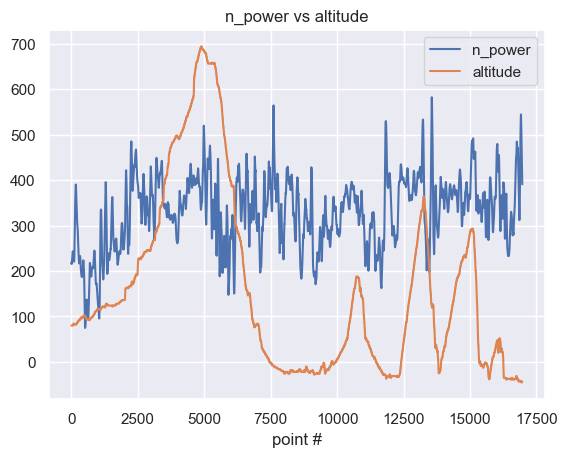

In [14]:
if POWER:
    plot_vs_altitude(df, col_name='n_power', smooth=True)

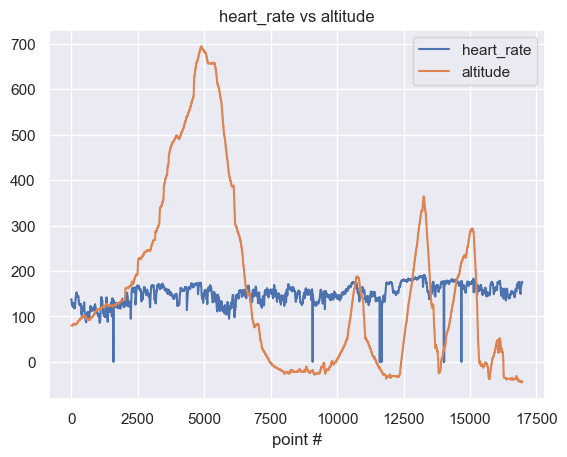

In [15]:
plot_vs_altitude(df, col_name='heart_rate')

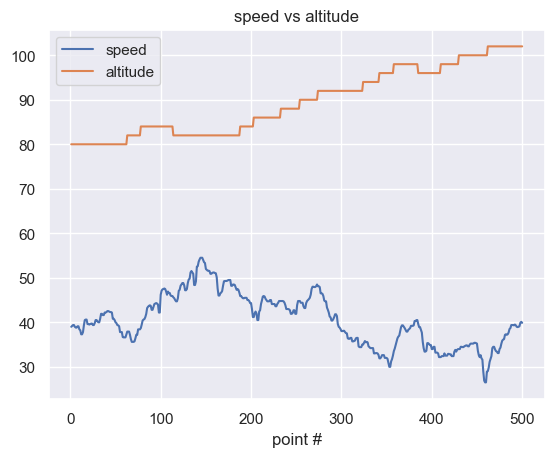

In [16]:
# to reduce # of points
plot_vs_altitude(df[:500], col_name='speed')

#### Displays trackpoints on a map

In [17]:
# remove eventually rows where lat, lon are nan
df = df.dropna()

m = folium.Map(location=[df['position_lat'][1], df['position_long'][1]], zoom_start=15)

cols_list = ['position_lat', 'position_long', 'altitude', 'speed']

if POWER:
    cols_list.append('power')
if CADENCE:
    cols_list.append('cadence')
    
for i, row in df[cols_list].iterrows():
    f_str = f"<b>Altitude: {row['altitude']} m.</b><br><b>Speed: {row['speed']} kmh</b>"

    if POWER:
        f_str += f"<br><b>Power: {row['power']} w."

    if CADENCE:
        f_str += f"<br><b>Cadence: {row['cadence']}"
        
    popup_html = folium.Popup(f_str, max_width=200)
    
    folium.CircleMarker(location=[row['position_lat'], row['position_long']],
                        popup=popup_html,
                        radius=3).add_to(m)

m